In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns
import geopandas as gpd
from shapely.geometry import Point
import plotly.express as px
from plotly.subplots import make_subplots
from shapely.geometry import Point
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.linear_model import ElasticNet
from xgboost import XGBRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import TruncatedSVD
from sklearn.pipeline import Pipeline,make_pipeline
from sklearn.tree import DecisionTreeRegressor
from scipy.stats import ttest_ind, f_oneway 
from feature_engine.encoding import RareLabelEncoder
from catboost import Pool, CatBoostRegressor
from sklearn.linear_model import Lasso

In [2]:
data = pd.read_csv("Listings.csv", encoding='unicode_escape', low_memory=False)

data.head(5)

,listing_id,name,host_id,host_since,host_location,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_total_listings_count,...,minimum_nights,maximum_nights,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable
0,281420,"Beautiful Flat in le Village Montmartre, Paris",1466919,2011-12-03,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f
1,3705183,39 mÃÂ² Paris (Sacre CÃ âur),10328771,2013-11-29,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f
2,4082273,"Lovely apartment with Terrace, 60m2",19252768,2014-07-31,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f
3,4797344,Cosy studio (close to Eiffel tower),10668311,2013-12-17,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f
4,4823489,Close to Eiffel Tower - Beautiful flat : 2 rooms,24837558,2014-12-14,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f


In [3]:
data.columns

Index(['listing_id', 'name', 'host_id', 'host_since', 'host_location',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_total_listings_count',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'district', 'city', 'latitude', 'longitude', 'property_type',
       'room_type', 'accommodates', 'bedrooms', 'amenities', 'price',
       'minimum_nights', 'maximum_nights', 'review_scores_rating',
       'review_scores_accuracy', 'review_scores_cleanliness',
       'review_scores_checkin', 'review_scores_communication',
       'review_scores_location', 'review_scores_value', 'instant_bookable'],
      dtype='object')

In [4]:
data.isna().sum()

listing_id                          0
name                              173
host_id                             0
host_since                        165
host_location                     840
host_response_time             128782
host_response_rate             128782
host_acceptance_rate           113087
host_is_superhost                 165
host_total_listings_count         165
host_has_profile_pic              165
host_identity_verified            165
neighbourhood                       0
district                       242700
city                                0
latitude                            0
longitude                           0
property_type                       0
room_type                           0
accommodates                        0
bedrooms                        29435
amenities                           0
price                               0
minimum_nights                      0
maximum_nights                      0
review_scores_rating            91405
review_score

In [5]:
data.shape

(279712, 33)

In [6]:
columns_to_drop = ['host_response_time','district','host_response_rate','host_acceptance_rate','review_scores_rating',
                   'review_scores_accuracy','review_scores_cleanliness','review_scores_checkin','review_scores_communication','review_scores_location',
                   'review_scores_value']
data.drop(columns = columns_to_drop, inplace = True)

In [7]:
data_cleaned = data.dropna()

In [8]:
data_cleaned.T

,0,1,2,3,4,5,6,7,8,9,...,279702,279703,279704,279705,279706,279707,279708,279709,279710,279711
listing_id,281420,3705183,4082273,4797344,4823489,4898654,6021700,6945740,7491966,7849932,...,36694889,36944049,37523165,38008602,38111942,38338635,38538692,38683356,39659000,40219504
name,"Beautiful Flat in le Village Montmartre, Paris",39 mÃÂ² Paris (Sacre CÃ âur),"Lovely apartment with Terrace, 60m2",Cosy studio (close to Eiffel tower),Close to Eiffel Tower - Beautiful flat : 2 rooms,NEW - Charming apartment Le Marais,2P - Entre Bastille et Republique,57sqm btw. Bastille & PÃÂ¨re Lachaise,Charming appartment near the Parc Buttes Chaumont,Bel appartement plein de charme !,...,Appartement charme Haussmanien Alesia.,Nid douillet Montorgueil,Appartement Paris 20ÃÂ¨me,Charmant appartement parisien sous les toits,"cocoon, cozy & surf spirit",Appartement T2 neuf prÃÂ¨s du tram T3a Porte ...,Cozy Studio in Montmartre,Nice and cosy mini-appartement in Paris,Charming apartment near Rue Saint Maur / Oberk...,Cosy apartment with view on Canal St Martin
host_id,1466919,10328771,19252768,10668311,24837558,505535,8053690,5924709,35812762,20833291,...,9681830,16315892,272481974,20504086,7841363,31161181,10294858,2238502,38633695,6955618
host_since,2011-12-03,2013-11-29,2014-07-31,2013-12-17,2014-12-14,2011-04-13,2013-08-09,2013-04-14,2015-06-14,2014-09-02,...,2013-10-28,2014-06-03,2019-06-30,2014-08-25,2013-07-31,2015-04-13,2013-11-27,2012-04-27,2015-07-16,2013-06-17
host_location,"Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France",...,"Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France"
host_is_superhost,f,f,f,f,f,f,f,f,f,f,...,f,f,f,f,f,f,f,f,f,f
host_total_listings_count,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
host_has_profile_pic,t,t,t,t,t,t,t,t,t,t,...,t,t,t,t,t,t,t,t,t,t
host_identity_verified,f,t,f,t,f,t,t,t,t,t,...,t,t,t,t,t,t,t,t,t,t
neighbourhood,Buttes-Montmartre,Buttes-Montmartre,Elysee,Vaugirard,Passy,Temple,Popincourt,Popincourt,Buttes-Chaumont,Opera,...,Observatoire,Bourse,Menilmontant,Enclos-St-Laurent,Batignolles-Monceau,Observatoire,Buttes-Montmartre,Buttes-Montmartre,Popincourt,Enclos-St-Laurent


In [9]:
data_cleaned.info()
data_cleaned.to_csv('air_bnb.csv',index=False)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 249389 entries, 0 to 279711
Data columns (total 22 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   listing_id                 249389 non-null  int64  
 1   name                       249389 non-null  object 
 2   host_id                    249389 non-null  int64  
 3   host_since                 249389 non-null  object 
 4   host_location              249389 non-null  object 
 5   host_is_superhost          249389 non-null  object 
 6   host_total_listings_count  249389 non-null  float64
 7   host_has_profile_pic       249389 non-null  object 
 8   host_identity_verified     249389 non-null  object 
 9   neighbourhood              249389 non-null  object 
 10  city                       249389 non-null  object 
 11  latitude                   249389 non-null  float64
 12  longitude                  249389 non-null  float64
 13  property_type              24

In [10]:
# Display basic statistics
print("Basic Statistics:")
print(data_cleaned.describe())

Basic Statistics:
         listing_id       host_id  host_total_listings_count       latitude  \
count  2.493890e+05  2.493890e+05              249389.000000  249389.000000   
mean   2.617670e+07  1.073569e+08                  22.236658      17.648673   
std    1.447029e+07  1.105982e+08                 256.809736      32.710678   
min    2.577000e+03  1.822000e+03                   0.000000     -34.264400   
25%    1.365794e+07  1.681687e+07                   1.000000     -22.969650   
50%    2.736635e+07  5.724332e+07                   1.000000      40.690960   
75%    3.967077e+07  1.818170e+08                   4.000000      41.899010   
max    4.834353e+07  3.901874e+08                7235.000000      48.904720   

           longitude   accommodates       bedrooms          price  \
count  249389.000000  249389.000000  249389.000000  249389.000000   
mean       12.532654       3.400808       1.515404     636.597188   
std        74.207527       2.191669       1.153138    3537.6611

In [11]:
main_label = 'price'
# Exclude 1% of smallest and 1% of highest prices
P = np.percentile(data_cleaned[main_label], [1, 99])
data_cleaned = data_cleaned[(data_cleaned[main_label] > P[0]) & (data_cleaned[main_label] < P[1])]

In [12]:
print(data_cleaned.describe())

         listing_id       host_id  host_total_listings_count       latitude  \
count  2.440700e+05  2.440700e+05              244070.000000  244070.000000   
mean   2.615500e+07  1.072090e+08                  22.033892      17.700050   
std    1.448673e+07  1.106162e+08                 256.692677      32.693958   
min    2.577000e+03  1.822000e+03                   0.000000     -34.264400   
25%    1.362008e+07  1.668530e+07                   1.000000     -22.969190   
50%    2.735386e+07  5.712712e+07                   1.000000      40.691120   
75%    3.966905e+07  1.815108e+08                   4.000000      41.899150   
max    4.834353e+07  3.901874e+08                7235.000000      48.904220   

           longitude   accommodates       bedrooms          price  \
count  244070.000000  244070.000000  244070.000000  244070.000000   
mean       12.410488       3.378559       1.499910     459.087422   
std        74.519268       2.130748       1.123399     768.450524   
min       -9

In [13]:
# the corr heatmap
corr_all = data_cleaned.corr(numeric_only=True)
corr_all['price']

listing_id                   0.039190
host_id                      0.037423
host_total_listings_count    0.017985
latitude                    -0.270667
longitude                    0.041541
accommodates                 0.292017
bedrooms                     0.263822
price                        1.000000
minimum_nights              -0.020943
maximum_nights              -0.001048
Name: price, dtype: float64

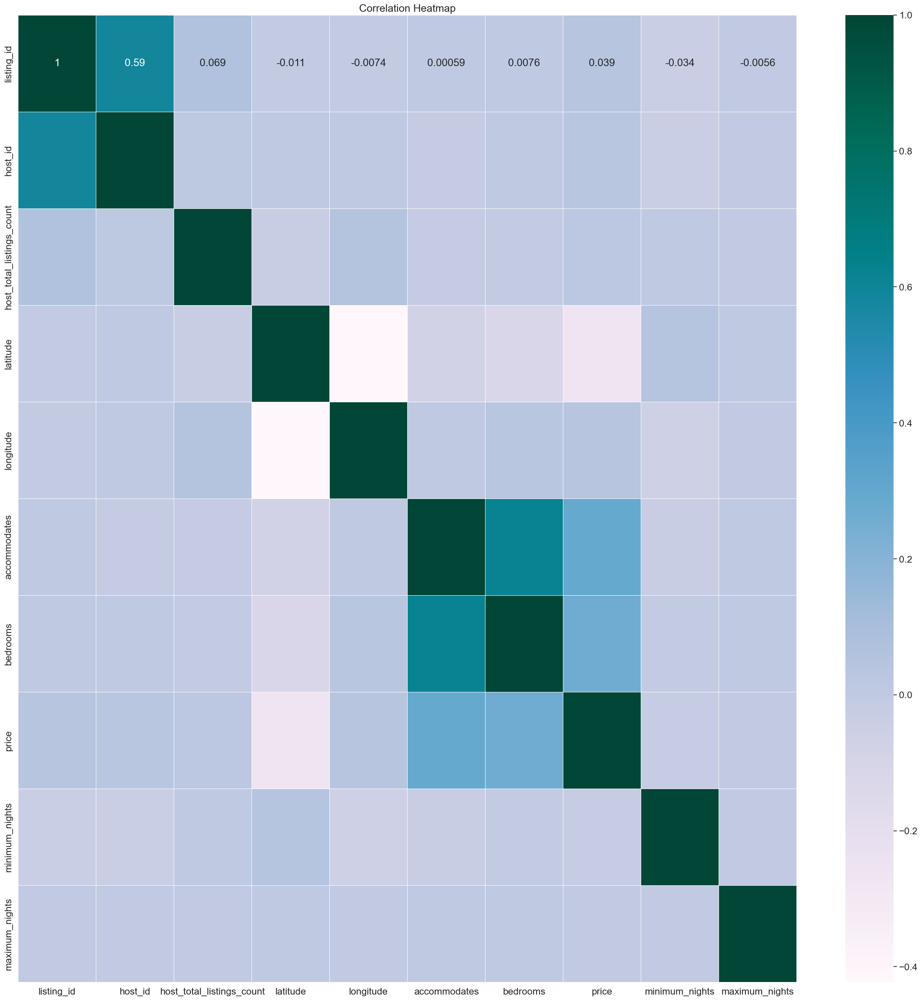

In [14]:
# EDA
sns.set(font_scale=1.5)

fig, ax = plt.subplots(figsize=(30, 30))
sns.heatmap(corr_all, cmap="PuBuGn", annot=True, linewidths=.5, ax=ax)

ax.set_title("Correlation Heatmap")

plt.show()

In [15]:
city_hotel_counts = data_cleaned['city'].value_counts().reset_index()
city_hotel_counts.columns = ['city', 'number_of_hotels']

fig = px.bar(city_hotel_counts, x='number_of_hotels', y='city', orientation='h',
             title='Number of Hotels in Each City', text='number_of_hotels',
            color_discrete_sequence=px.colors.qualitative.Pastel)


fig.update_layout(yaxis=dict(categoryorder='total ascending'), xaxis_title='Number of Hotels')

fig.show()

In [16]:
fig = px.scatter_mapbox(data_cleaned, lat='latitude', lon='longitude', text='city', hover_name='city', size='price',
                        size_max=40, zoom=1, title='Price Comparison and distribution of hotels across cities')

fig.update_layout(mapbox_style="carto-positron", showlegend=False, height=600)

fig.show()

In [17]:
filtered_df = data[data['price'] > 100000]
fig = px.treemap(
    filtered_df,
    path=['city', 'name', 'amenities'],
    values='price',
    hover_data=['neighbourhood'],
    title='Hotels which have Price more than > 100000',
    color_discrete_sequence=px.colors.diverging.RdBu,
)


fig.update_traces(
    hovertemplate='City: %{id}<br>Hotel: %{label}<br>Price: $%{value:.2f}',
)
fig.update_traces(root_color="lightgrey")
fig.update_layout(margin = dict(t=50, l=25, r=25, b=25))

fig.show()

In [18]:
highPrice = data[data['price'] > 100000]
lowPrice = data[data['price'] < 1000]


# Assuming df_high_price and df_low_price are your DataFrames with prices > 100k and < 1k respectively
common_neighborhoods = set(highPrice['neighbourhood']).intersection(set(lowPrice['neighbourhood']))
common_neighborhood_df = highPrice[highPrice['neighbourhood'].isin(common_neighborhoods)]
neighborhood_counts = common_neighborhood_df['neighbourhood'].value_counts().reset_index().rename(columns={'index': 'neighbourhood', 'neighbourhood': 'count'})
neighborhood_counts.columns = ['neighbourhood', 'count']

styled_neighborhood_counts = neighborhood_counts.style.background_gradient(axis=0, cmap='YlOrBr', subset=["count"])

styled_neighborhood_counts = neighborhood_counts.style.bar(
    subset=["count"],
    cmap='RdBu',  
).set_table_styles([
    {
        'selector': 'table',
        'props': [
            ('border-collapse', 'collapse'),
            ('border', '2px solid black'),
            ('background-color', '#f2f2f2'),
        ],
    },
    {
        'selector': 'th, td',
        'props': [('border', '1px solid black')],
    },
]).set_properties(**{'font-weight': 'bold'})

styled_neighborhood_counts

,neighbourhood,count
0,Ward 54,13
1,Copacabana,9
2,Fatih,5
3,Khlong Toei,3
4,Miguel Hidalgo,3
5,Barra da Tijuca,2
6,Botafogo,2
7,Guaratiba,1
8,Santa Teresa,1
9,Lagoa,1


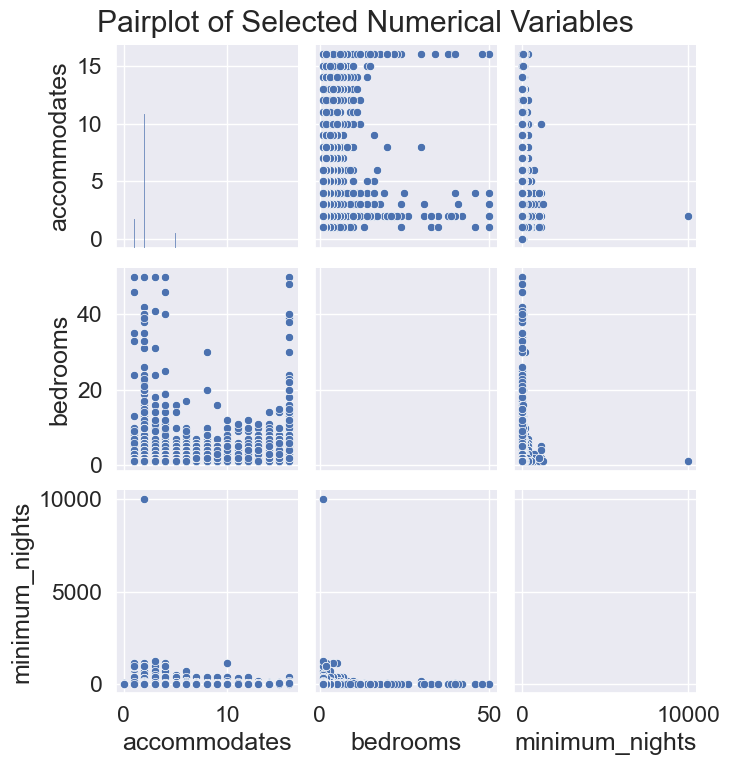

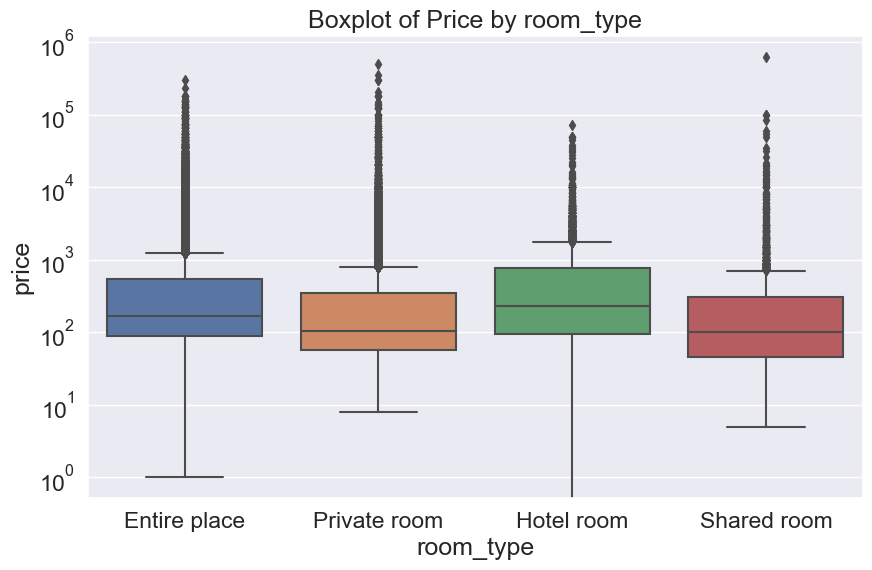

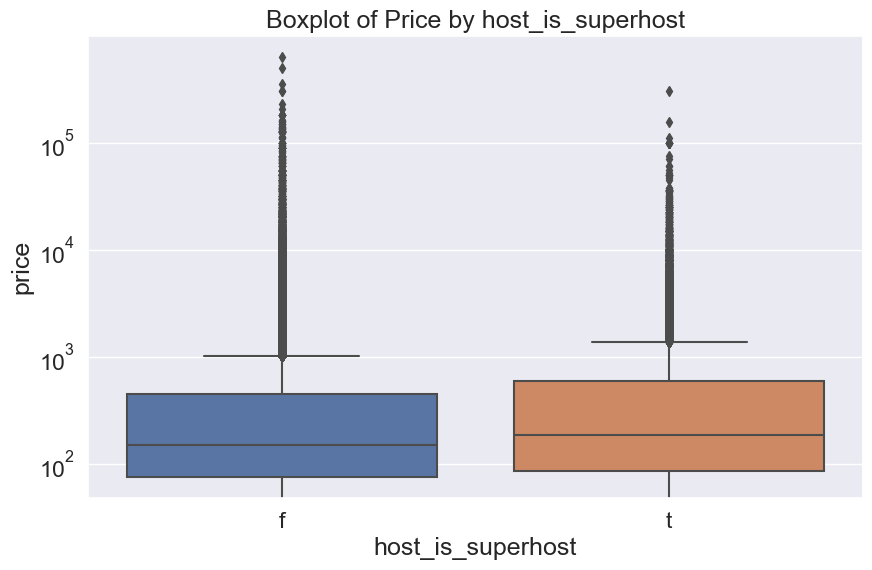

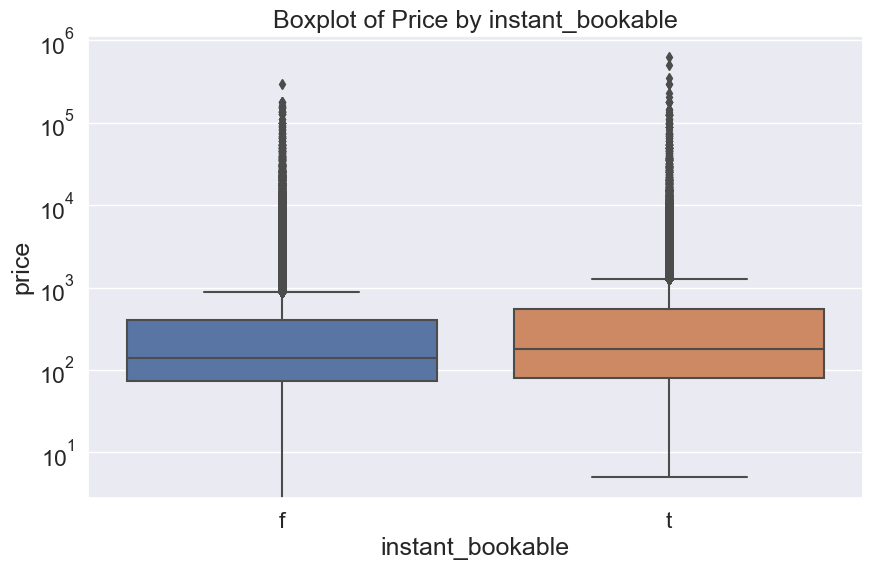

In [19]:
# Pairplot for selected numerical variables
numerical_vars = ['accommodates', 'bedrooms', 'minimum_nights']
sns.pairplot(data[numerical_vars])
plt.suptitle('Pairplot of Selected Numerical Variables', y=1.02)
plt.show()

# Boxplot for categorical variables
categorical_vars = ['room_type', 'host_is_superhost', 'instant_bookable']
for var in categorical_vars:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x=var, y='price', data=data)
    plt.yscale('log') # using log scaled y axis to have a good look on boxplot
    plt.title(f'Boxplot of Price by {var}')
    plt.show()

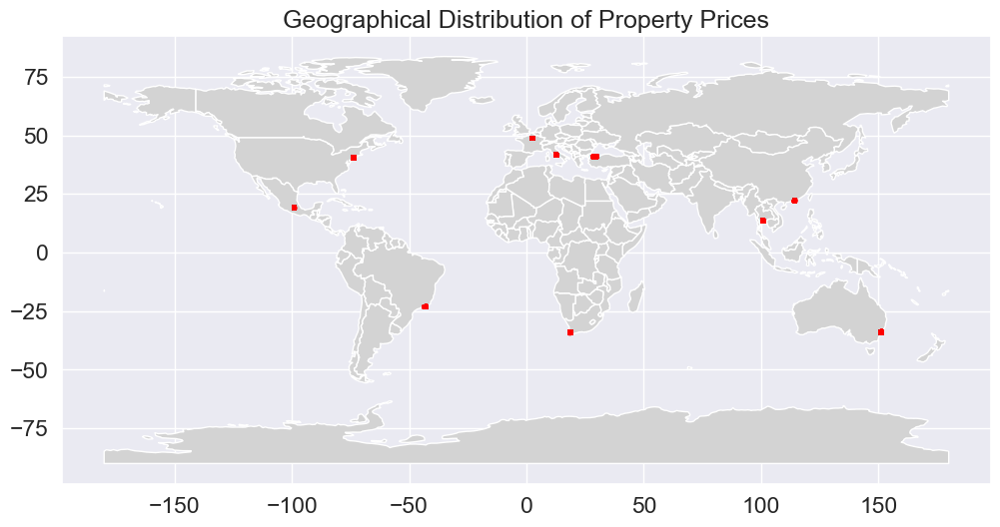

In [20]:
geometry = [Point(xy) for xy in zip(data_cleaned['longitude'], data_cleaned['latitude'])]
gdf = gpd.GeoDataFrame(data_cleaned, geometry=geometry)


world = gpd.read_file('ne_110m_admin_0_countries.shp')

fig, ax = plt.subplots(figsize=(12, 8))
world.plot(ax=ax, color='lightgrey')


gdf.plot(ax=ax, markersize=5, color='red', alpha=0.5)

plt.title('Geographical Distribution of Property Prices')
plt.show()

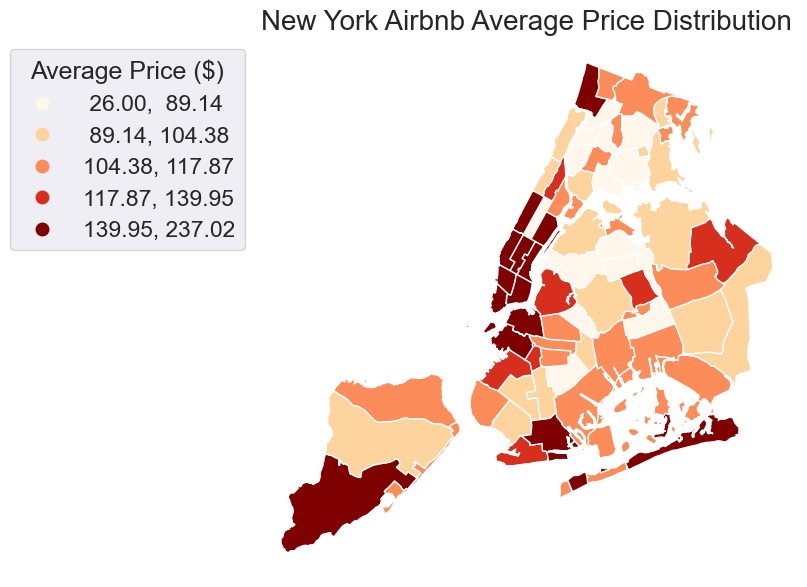

In [21]:
# New York geopandas 
# Can only do New York because it is hard to find other city shapefiles

# Load New York geographic data
ny_zone = gpd.read_file('new_york_boundries.shp')
ny_zone.crs = "EPSG:4326"

# Add a unique identifier to each zone
ny_zone['POLY_ID'] = range(1, len(ny_zone) + 1)

# Prepare the Airbnb data
geometry = [Point(xy) for xy in zip(data_cleaned['longitude'], data_cleaned['latitude'])]
airbnb_gdf = gpd.GeoDataFrame(data_cleaned, geometry=geometry)
airbnb_gdf.crs = "EPSG:4326"

# Perform Spatial Join using 'predicate' instead of 'op'
airbnb_zone = gpd.sjoin(airbnb_gdf, ny_zone, how="inner", predicate="within")

# Calculate Average Prices by the 'POLY_ID', explicitly setting numeric_only
meanprice = airbnb_zone.groupby('POLY_ID').mean(numeric_only=True)['price']
meanprice = meanprice.to_frame()

# Merge the average prices back into the ny_zone GeoDataFrame
final_zone = ny_zone.merge(meanprice, how='left', on='POLY_ID')
final_zone['price'].fillna(final_zone['price'].mean(), inplace=True)

# Plot the distribution of Average Price in New York
def pricemap_ny():
    f, ax = plt.subplots(figsize=(10, 7))
    final_zone.plot(ax=ax, column='price', cmap='OrRd', scheme='quantiles', legend=True)
    ax.axis('off')
    ax.set_title('New York Airbnb Average Price Distribution', fontdict={'fontsize': '20', 'fontweight': '3'})
    # Adjust the legend size and location
    leg = ax.get_legend()
    leg.set_bbox_to_anchor((0, 1))  # Moves the legend to the top left
    leg.set_frame_on(True)  # Optionally add a frame around the legend
    leg.set_title("Average Price ($)")
    plt.show()

pricemap_ny()

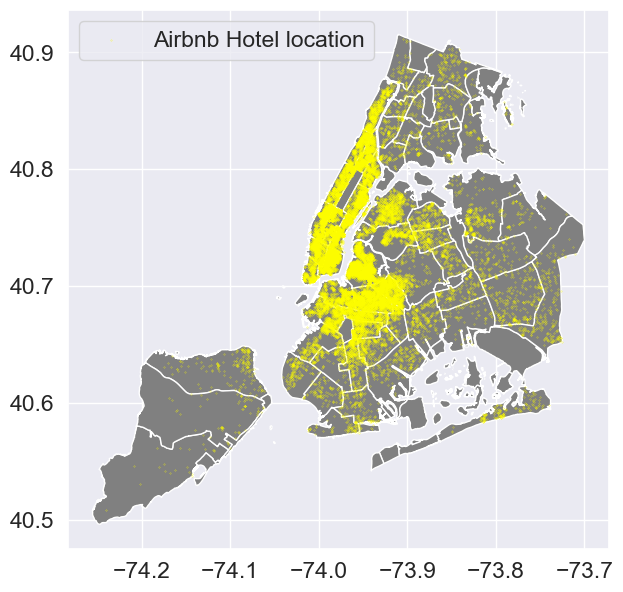

In [22]:
#plot the loction of airbnb new york
def location():
  f,ax = plt.subplots(figsize=(10,7))

  ny_zone.plot(ax=ax, facecolor='gray')

  airbnb_zone.plot(ax=ax, color='yellow', markersize=0.04)

  plt.legend(['Airbnb Hotel location'])

location()

In [23]:
# Now it is time for modeling!
# We need to conduct a linear regression as a baseline

In [24]:
data_cleaned

,listing_id,name,host_id,host_since,host_location,host_is_superhost,host_total_listings_count,host_has_profile_pic,host_identity_verified,neighbourhood,...,longitude,property_type,room_type,accommodates,bedrooms,amenities,price,minimum_nights,maximum_nights,instant_bookable
0,281420,"Beautiful Flat in le Village Montmartre, Paris",1466919,2011-12-03,"Paris, Ile-de-France, France",f,1.0,t,f,Buttes-Montmartre,...,2.33343,Entire apartment,Entire place,2,1.0,"[""Heating"", ""Kitchen"", ""Washer"", ""Wifi"", ""Long...",53,2,1125,f
1,3705183,39 mÃÂ² Paris (Sacre CÃ âur),10328771,2013-11-29,"Paris, Ile-de-France, France",f,1.0,t,t,Buttes-Montmartre,...,2.34515,Entire apartment,Entire place,2,1.0,"[""Shampoo"", ""Heating"", ""Kitchen"", ""Essentials""...",120,2,1125,f
2,4082273,"Lovely apartment with Terrace, 60m2",19252768,2014-07-31,"Paris, Ile-de-France, France",f,1.0,t,f,Elysee,...,2.31712,Entire apartment,Entire place,2,1.0,"[""Heating"", ""TV"", ""Kitchen"", ""Washer"", ""Wifi"",...",89,2,1125,f
3,4797344,Cosy studio (close to Eiffel tower),10668311,2013-12-17,"Paris, Ile-de-France, France",f,1.0,t,t,Vaugirard,...,2.30584,Entire apartment,Entire place,2,1.0,"[""Heating"", ""TV"", ""Kitchen"", ""Wifi"", ""Long ter...",58,2,1125,f
4,4823489,Close to Eiffel Tower - Beautiful flat : 2 rooms,24837558,2014-12-14,"Paris, Ile-de-France, France",f,1.0,t,f,Passy,...,2.26979,Entire apartment,Entire place,2,1.0,"[""Heating"", ""TV"", ""Kitchen"", ""Essentials"", ""Ha...",60,2,1125,f
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
279707,38338635,Appartement T2 neuf prÃÂ¨s du tram T3a Porte ...,31161181,2015-04-13,"Paris, Ile-de-France, France",f,1.0,t,t,Observatoire,...,2.31419,Entire apartment,Entire place,2,1.0,"[""Iron"", ""Heating"", ""Washer"", ""Dedicated works...",120,1,7,f
279708,38538692,Cozy Studio in Montmartre,10294858,2013-11-27,"Paris, Ile-de-France, France",f,1.0,t,t,Buttes-Montmartre,...,2.33206,Entire apartment,Entire place,2,1.0,"[""Shampoo"", ""Iron"", ""Heating"", ""Washer"", ""Hair...",60,7,15,f
279709,38683356,Nice and cosy mini-appartement in Paris,2238502,2012-04-27,"Paris, Ile-de-France, France",f,1.0,t,t,Buttes-Montmartre,...,2.34920,Entire apartment,Entire place,2,1.0,"[""Paid parking off premises"", ""Shampoo"", ""Firs...",50,6,30,f
279710,39659000,Charming apartment near Rue Saint Maur / Oberk...,38633695,2015-07-16,"Paris, Ile-de-France, France",f,1.0,t,t,Popincourt,...,2.38123,Entire apartment,Entire place,2,1.0,"[""TV"", ""Iron"", ""Kitchen"", ""Hangers"", ""Smoke al...",105,3,18,f


In [25]:
data_cleaned.columns
# log10-transform columns and group for larger bins
for col in ['minimum_nights', 'host_total_listings_count']:
    data_cleaned[f'log10_{col}'] = data_cleaned[col].apply(lambda x: 1/5*round(5*np.log10(1+x)))
    data_cleaned = data_cleaned.drop([col], axis=1)
# set up the rare label encoder limiting number of categories to max_n_categories
for col in ['neighbourhood', 'room_type','host_is_superhost','instant_bookable']:
    encoder = RareLabelEncoder(n_categories=1, max_n_categories=70, replace_with='Other', tol=20/data_cleaned.shape[0])
    data_cleaned[col] = encoder.fit_transform(data_cleaned[[col]])

data_cleaned.T

,0,1,2,3,4,5,6,7,8,9,...,279702,279703,279704,279705,279706,279707,279708,279709,279710,279711
listing_id,281420,3705183,4082273,4797344,4823489,4898654,6021700,6945740,7491966,7849932,...,36694889,36944049,37523165,38008602,38111942,38338635,38538692,38683356,39659000,40219504
name,"Beautiful Flat in le Village Montmartre, Paris",39 mÃÂ² Paris (Sacre CÃ âur),"Lovely apartment with Terrace, 60m2",Cosy studio (close to Eiffel tower),Close to Eiffel Tower - Beautiful flat : 2 rooms,NEW - Charming apartment Le Marais,2P - Entre Bastille et Republique,57sqm btw. Bastille & PÃÂ¨re Lachaise,Charming appartment near the Parc Buttes Chaumont,Bel appartement plein de charme !,...,Appartement charme Haussmanien Alesia.,Nid douillet Montorgueil,Appartement Paris 20ÃÂ¨me,Charmant appartement parisien sous les toits,"cocoon, cozy & surf spirit",Appartement T2 neuf prÃÂ¨s du tram T3a Porte ...,Cozy Studio in Montmartre,Nice and cosy mini-appartement in Paris,Charming apartment near Rue Saint Maur / Oberk...,Cosy apartment with view on Canal St Martin
host_id,1466919,10328771,19252768,10668311,24837558,505535,8053690,5924709,35812762,20833291,...,9681830,16315892,272481974,20504086,7841363,31161181,10294858,2238502,38633695,6955618
host_since,2011-12-03,2013-11-29,2014-07-31,2013-12-17,2014-12-14,2011-04-13,2013-08-09,2013-04-14,2015-06-14,2014-09-02,...,2013-10-28,2014-06-03,2019-06-30,2014-08-25,2013-07-31,2015-04-13,2013-11-27,2012-04-27,2015-07-16,2013-06-17
host_location,"Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France",...,"Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France","Paris, Ile-de-France, France"
host_is_superhost,f,f,f,f,f,f,f,f,f,f,...,f,f,f,f,f,f,f,f,f,f
host_has_profile_pic,t,t,t,t,t,t,t,t,t,t,...,t,t,t,t,t,t,t,t,t,t
host_identity_verified,f,t,f,t,f,t,t,t,t,t,...,t,t,t,t,t,t,t,t,t,t
neighbourhood,Buttes-Montmartre,Buttes-Montmartre,Elysee,Vaugirard,Passy,Temple,Popincourt,Popincourt,Buttes-Chaumont,Opera,...,Observatoire,Bourse,Menilmontant,Enclos-St-Laurent,Batignolles-Monceau,Observatoire,Buttes-Montmartre,Buttes-Montmartre,Popincourt,Enclos-St-Laurent
city,Paris,Paris,Paris,Paris,Paris,Paris,Paris,Paris,Paris,Paris,...,Paris,Paris,Paris,Paris,Paris,Paris,Paris,Paris,Paris,Paris


In [26]:
X = data_cleaned[['host_is_superhost','room_type', 'accommodates','bedrooms', 'neighbourhood',
                'log10_minimum_nights','instant_bookable','amenities',
                'log10_host_total_listings_count']]
y = data_cleaned['price']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train

,host_is_superhost,room_type,accommodates,bedrooms,neighbourhood,log10_minimum_nights,instant_bookable,amenities,log10_host_total_listings_count
29469,f,Entire place,2,1.0,Ipanema,0.8,f,"[""Air conditioning"", ""Gym"", ""Essentials"", ""Lug...",0.4
35350,f,Entire place,6,2.0,Cuauhtemoc,0.4,f,"[""TV"", ""Dedicated workspace"", ""Shampoo"", ""Esse...",0.4
16921,f,Entire place,3,2.0,Ward 115,0.4,f,"[""Hair dryer"", ""Dryer"", ""Hot water"", ""Heating""...",0.4
246945,t,Entire place,8,4.0,I Centro Storico,0.4,t,"[""Dishwasher"", ""Paid parking off premises"", ""P...",1.6
196227,f,Private room,1,1.0,Waverley,0.6,t,"[""Patio or balcony"", ""Bed linens"", ""Coffee mak...",0.4
...,...,...,...,...,...,...,...,...,...
139955,f,Private room,3,1.0,Sydney,0.4,t,"[""Long term stays allowed"", ""Ceiling fan"", ""Lo...",0.0
123274,f,Private room,1,1.0,Woollahra,0.8,f,"[""Washer"", ""Iron"", ""Long term stays allowed"", ...",0.4
152407,f,Hotel room,2,1.0,I Centro Storico,0.4,t,"[""Shampoo"", ""Air conditioning"", ""Hangers"", ""Ha...",0.4
167866,f,Private room,2,1.0,Sydney,0.4,t,"[""Long term stays allowed"", ""Hot water"", ""Esse...",3.8


In [27]:
text_features = ['amenities']
# Create a pipeline for text processing
text_ff = Pipeline([
    ('tfidf', TfidfVectorizer()),
    ('svd', TruncatedSVD(n_components=10))
])

# Process the text feature on training data
text_train = text_ff.fit_transform(X_train[text_features[0]].astype(str))
text_train = pd.DataFrame(text_train, columns=[f'text{i}' for i in range(10)])

# Process the text feature on test data using the fitted pipeline
text_test = text_ff.transform(X_test[text_features[0]].astype(str))
text_test = pd.DataFrame(text_test, columns=[f'text{i}' for i in range(10)])

# Reset index before merging
X_train = X_train.reset_index(drop=True)
X_test = X_test.reset_index(drop=True)
y_train = y_train.reset_index(drop=True)
y_test = y_test.reset_index(drop=True)

# Merge the new text features
X_train = X_train.merge(text_train, left_index=True, right_index=True)
X_test = X_test.merge(text_test, left_index=True, right_index=True)

# Drop the original 'amenities' column
X_train.drop('amenities', axis=1, inplace=True)
X_test.drop('amenities', axis=1, inplace=True)

In [28]:
# linear_regression baseline model
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), ['accommodates','bedrooms']),
        ('ord', OneHotEncoder(), ['neighbourhood', 'room_type','host_is_superhost','instant_bookable'])
    ])

# Pipeline
baseline_model = Pipeline(steps=[('preprocessor', preprocessor),
                        ('regressor', LinearRegression())])

baseline_model.fit(X_train, y_train)
y_pred = baseline_model.predict(X_test)

rmse = np.sqrt(mean_squared_error(y_test,y_pred))
print('baseline_model RMSE:', rmse)
r2 = r2_score(y_test,y_pred)
print("R-squared:", r2)

baseline_model RMSE: 632.5898571056628
R-squared: 0.35034844700498624


In [29]:
# decision_tree baseline model

# Define the preprocessor as part of the pipeline
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), ['accommodates','bedrooms']),
        ('ord', OneHotEncoder(), ['neighbourhood', 'room_type','host_is_superhost','instant_bookable'])
    ])

# Pipeline with decision tree regressor
tree_model = Pipeline(steps=[('preprocessor', preprocessor),
                             ('regressor', DecisionTreeRegressor())])

# Parameter grid for GridSearchCV
param_grid = {
    'regressor__max_depth': [2, 5, 10, 20],
    'regressor__min_samples_split': [2, 5, 10],
    'regressor__min_samples_leaf': [1, 2, 4]
}

# Grid search with cross-validation
grid_search = GridSearchCV(tree_model, param_grid, cv=5, scoring='neg_mean_squared_error', verbose=1, n_jobs=-1)

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

# Best estimator found by grid search
print('Best parameters found:', grid_search.best_params_)

# Predict using the best model
y_pred = grid_search.predict(X_test)

# Calculate RMSE and R-squared
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)

print('Decision Tree RMSE:', rmse)
print('R-squared:', r2)

Fitting 5 folds for each of 36 candidates, totalling 180 fits
Best parameters found: {'regressor__max_depth': 20, 'regressor__min_samples_leaf': 4, 'regressor__min_samples_split': 10}
Decision Tree RMSE: 594.990379017017
R-squared: 0.42528051817259704


In [30]:
# Define the preprocessor as before
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), ['accommodates','bedrooms']),
        ('ord', OneHotEncoder(), ['neighbourhood', 'room_type','host_is_superhost','instant_bookable'])
    ])

# Define the pipeline with a random forest regressor
rf_model = Pipeline(steps=[('preprocessor', preprocessor),
                           ('regressor', RandomForestRegressor())])

# Define the parameter grid for the RandomForestRegressor
param_grid = {
    'regressor__n_estimators': [100,200,300],  # The number of trees in the forest
    'regressor__max_depth': [3,4,5,6,7,8,10,20],  # The maximum depth of the trees
}

# Create the GridSearchCV object
grid_search = GridSearchCV(rf_model, param_grid, cv=5, scoring='neg_mean_squared_error', verbose=1, n_jobs=-1)

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

# Get the best estimator
print('Best parameters found:', grid_search.best_params_)

# Predict using the best model
y_pred = grid_search.predict(X_test)

# Calculate RMSE and R-squared
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)

print('Random Forest RMSE:', rmse)
print('R-squared:', r2)

Fitting 5 folds for each of 24 candidates, totalling 120 fits
Best parameters found: {'regressor__max_depth': 20, 'regressor__n_estimators': 300}
Random Forest RMSE: 592.8527696246448
R-squared: 0.42940266520648673


In [31]:
# Define the preprocessor
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), ['accommodates','bedrooms']),
        ('ord', OneHotEncoder(), ['neighbourhood', 'room_type','host_is_superhost','instant_bookable'])])

# Define the pipeline with Lasso regression
lasso_pipeline = Pipeline(steps=[('preprocessor', preprocessor),
                                 ('regressor', Lasso())])

# Define the parameter grid to search
param_grid = {
    'regressor__alpha': [0.001, 0.01, 0.1, 1, 10, 100]
}

# Create the GridSearchCV object
grid_search = GridSearchCV(lasso_pipeline, param_grid, cv=5)

# Fit the model
grid_search.fit(X_train, y_train)

# Predict and evaluate
y_pred_lasso = grid_search.predict(X_test)

rmse_lasso = np.sqrt(mean_squared_error(y_test, y_pred_lasso))
r2_lasso = r2_score(y_test, y_pred_lasso)

print('Lasso Model RMSE:', rmse_lasso)
print("Lasso Model R-squared:", r2_lasso)

c:\Users\gjj71\anaconda3\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:589: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 19589145692.517525, tolerance: 9103540.897708528

c:\Users\gjj71\anaconda3\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:589: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 19606694687.45038, tolerance: 9133421.68703844

c:\Users\gjj71\anaconda3\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:589: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 19405724175.84343, tolerance: 9071295.472379722

c:\Users\gjj71\anaconda3\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:589: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 19679128462.607048, toler

Lasso Model RMSE: 632.5899894878543
Lasso Model R-squared: 0.3503481750995666


c:\Users\gjj71\anaconda3\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:589: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 24508807183.322662, tolerance: 11405700.670900607



In [32]:
# Define the preprocessor
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), ['accommodates','bedrooms']),
        ('ord', OneHotEncoder(), ['neighbourhood', 'room_type','host_is_superhost','instant_bookable'])])

# Define the pipeline with Gradient Boosting Regressor
gbr_pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', GradientBoostingRegressor(random_state=42))
])

# Define the parameter grid to search
param_grid = {
    'regressor__n_estimators': [100, 200],  # Number of boosting stages to perform
    'regressor__learning_rate': [0.01, 0.1],  # Learning rate shrinks the contribution of each tree
    'regressor__max_depth': [3, 4, 5],  # Maximum depth of the individual regression estimators
    'regressor__min_samples_split': [2, 3],  # The minimum number of samples required to split an internal node
    'regressor__min_samples_leaf': [1, 2]  # The minimum number of samples required to be at a leaf node
}

# Create the GridSearchCV object
grid_search = GridSearchCV(gbr_pipeline, param_grid, cv=5, scoring='neg_mean_squared_error', n_jobs=-1, verbose=2)

# Fit the model
grid_search.fit(X_train, y_train)

# Best estimator found by grid search
print('Best parameters found:', grid_search.best_params_)

# Predict and evaluate
y_pred_gbr = grid_search.predict(X_test)

# Calculate RMSE and R-squared
rmse_gbr = mean_squared_error(y_test, y_pred_gbr, squared=False)
r2_gbr = r2_score(y_test, y_pred_gbr)

print('Gradient Boosting Regressor RMSE:', rmse_gbr)
print('Gradient Boosting Regressor R-squared:', r2_gbr)

Fitting 5 folds for each of 48 candidates, totalling 240 fits
Best parameters found: {'regressor__learning_rate': 0.1, 'regressor__max_depth': 5, 'regressor__min_samples_leaf': 2, 'regressor__min_samples_split': 2, 'regressor__n_estimators': 200}
Gradient Boosting Regressor RMSE: 585.7016133291675
Gradient Boosting Regressor R-squared: 0.44308505409321475


In [33]:
# Define the preprocessor
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), ['accommodates','bedrooms']),
        ('ord', OneHotEncoder(), ['neighbourhood', 'room_type','host_is_superhost','instant_bookable'])])

# Define the pipeline with Elastic Net regression
elastic_net_pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', ElasticNet(random_state=42))
])

# Define the parameter grid to search
param_grid = {
    'regressor__alpha': [0.1, 1, 10],  # Constant that multiplies the penalty terms
    'regressor__l1_ratio': [0.1, 0.5, 0.9],  # The ElasticNet mixing parameter
    'regressor__max_iter': [1000]  # Number of iterations to converge
}

# Create the GridSearchCV object
grid_search = GridSearchCV(elastic_net_pipeline, param_grid, cv=5, scoring='neg_mean_squared_error', n_jobs=-1, verbose=2)

# Fit the model
grid_search.fit(X_train, y_train)

# Best estimator found by grid search
print('Best parameters found:', grid_search.best_params_)

# Predict and evaluate
y_pred_elastic_net = grid_search.predict(X_test)

# Calculate RMSE and R-squared
rmse_elastic_net = mean_squared_error(y_test, y_pred_elastic_net, squared=False)
r2_elastic_net = r2_score(y_test, y_pred_elastic_net)

print('Elastic Net RMSE:', rmse_elastic_net)
print('Elastic Net R-squared:', r2_elastic_net)

Fitting 5 folds for each of 9 candidates, totalling 45 fits
Best parameters found: {'regressor__alpha': 0.1, 'regressor__l1_ratio': 0.9, 'regressor__max_iter': 1000}
Elastic Net RMSE: 663.4913146653049
Elastic Net R-squared: 0.2853284120050992


In [34]:
# Define the preprocessor
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), ['accommodates','bedrooms']),
        ('ord', OneHotEncoder(), ['neighbourhood', 'room_type','host_is_superhost','instant_bookable'])
    ])

# Pipeline with XGBoost regressor
xgb_model = Pipeline(steps=[('preprocessor', preprocessor),
                            ('regressor', XGBRegressor())])

# Parameter grid for XGBoost
param_grid = {
    'regressor__n_estimators': [100, 200],  # Number of gradient boosted trees. Equivalent to number of boosting rounds
    'regressor__learning_rate': [0.01, 0.1],  # Boosting learning rate (xgb's "eta")
    'regressor__max_depth': [3, 6],  # Maximum depth of a tree
    'regressor__subsample': [0.7, 1],  # Subsample ratio of the training instances
    'regressor__colsample_bytree': [0.7, 1]  # Subsample ratio of columns when constructing each tree
}

# Create the GridSearchCV object
grid_search = GridSearchCV(xgb_model, param_grid, cv=5, scoring='neg_mean_squared_error', verbose=1, n_jobs=-1)

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

# Best estimator found by grid search
print('Best parameters found:', grid_search.best_params_)

# Predict using the best model
y_pred = grid_search.predict(X_test)

# Calculate RMSE and R-squared
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)

print('XGBoost Regressor RMSE:', rmse)
print('R-squared:', r2)

Fitting 5 folds for each of 32 candidates, totalling 160 fits
Best parameters found: {'regressor__colsample_bytree': 0.7, 'regressor__learning_rate': 0.1, 'regressor__max_depth': 6, 'regressor__n_estimators': 200, 'regressor__subsample': 0.7}
XGBoost Regressor RMSE: 580.9639058571937
R-squared: 0.4520583220544864


In [35]:
y = data_cleaned[main_label].values.reshape(-1,)
X = data_cleaned.drop([main_label], axis=1)
cat_cols = data_cleaned.select_dtypes(include=['object']).columns
cat_cols_idx = [list(X.columns).index(c) for c in cat_cols]
X_train,X_test,y_train,y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

# initialize Pool
train_pool = Pool(X_train, 
                  y_train, 
                  cat_features=cat_cols_idx)
test_pool = Pool(X_test,
                 y_test,
                 cat_features=cat_cols_idx)
# specify the training parameters 
model = CatBoostRegressor(iterations=1000, 
                          depth=7,
                          verbose=0,
                          learning_rate=0.01, 
                          loss_function='RMSE')
# train the model
model.fit(train_pool)

# Predict using the best model
y_pred = model.predict(X_test)

# Calculate RMSE and R-squared
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)

print('catboost Regressor RMSE:', rmse)
print('R-squared:', r2)

catboost Regressor RMSE: 471.864265910245
R-squared: 0.6385317039368426


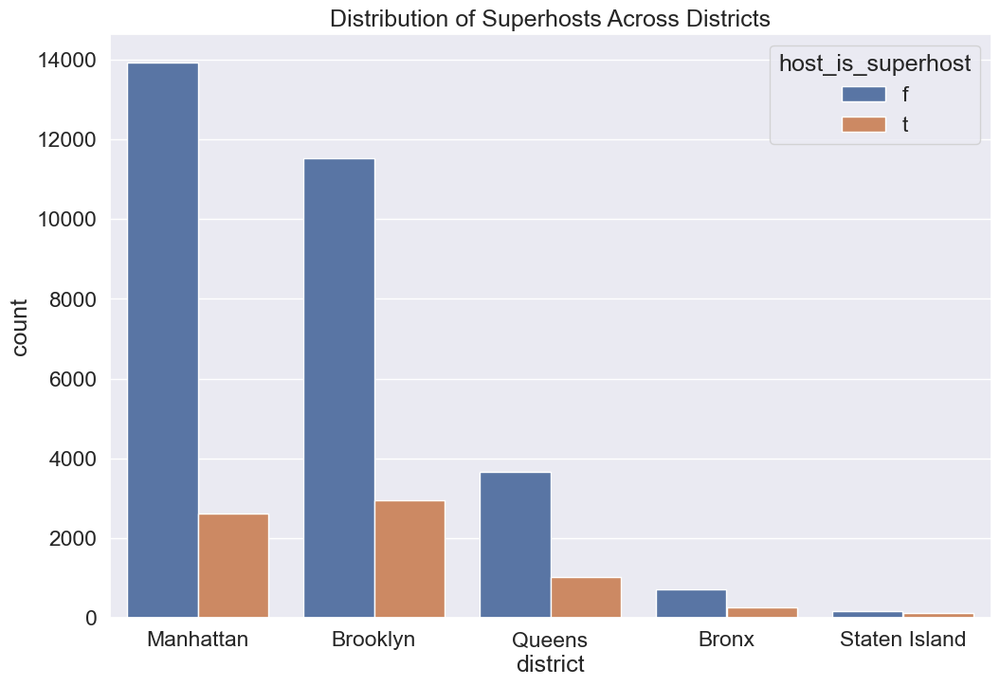

T-test Results:
T-statistic: 3.987222950284716
P-value: 6.686817236530981e-05

ANOVA Results:
F-statistic: nan
P-value: nan


In [36]:
data = pd.read_csv("Listings.csv", encoding='unicode_escape', low_memory=False)
plt.figure(figsize=(12, 8))
sns.countplot(x='district', hue='host_is_superhost', data=data)
plt.title('Distribution of Superhosts Across Districts')
plt.show()

superhost_prices = data[data['host_is_superhost'] == 't']['price']
non_superhost_prices = data[data['host_is_superhost'] == 'f']['price']
 
 
t_stat, p_value = ttest_ind(superhost_prices, non_superhost_prices)
print("T-test Results:")
print("T-statistic:", t_stat)
print("P-value:", p_value)

anova_results = f_oneway(data[data['host_is_superhost'] == 't']['review_scores_rating'],
                         data[data['host_is_superhost'] == 'f']['review_scores_rating'])
print("\nANOVA Results:")
print("F-statistic:", anova_results.statistic)
print("P-value:", anova_results.pvalue)

#The T-test results indicate a statistically significant difference in pricing between districts with and without superhosts
#The ANOVA results indicate a statistically significant difference in customer satisfaction between districts with and without superhosts
#Districts with superhosts tend to have both higher prices and higher customer satisfaction